# Latar Belakang
Tidak dipungkiri lagi bahwa bisnis persewaan properti sangat berpengaruh untuk kemajuan pariwisata suatu daerah. Airbnb hadir untuk menjadi bagian dari kemajuan tersebut. Airbnb adalah sebuah perusahaan asal Amerika Serikat yang menawarkan jasa sewa tempat tinggal sementara berbasis *online* di mana Airbnb sebagai perantara bekerjasama dengan para pemilik penginapan untuk menyewakan propertinya, dan Airbnb mengenakan komisi di setiap transaksinya. Konsumen dapat melakukan transaksi 24/7, kapanpun dan di manapun. Semakin banyak konsumen yang melakukan transaksi di Airbnb, maka semakin tinggi pula pendapatan perusahaan tersebut. Terdapat banyak *listing* Airbnb di daerah Bangkok, Thailand, tetapi tidak semuanya menjadi pilihan bagi konsumen untuk menginap. Tentu hal ini akan berpengaruh terhadap pendapatan Airbnb.

# Pernyataan Masalah
Airbnb ingin melakukan riset karakteristik properti (*listing*) seperti apa yang menjadi pilihan utama bagi konsumen untuk menginap di daerah Bangkok, Thailand. Hal ini bertujuan untuk mendapatkan profit yang lebih tinggi bagi perusahaan.

Sebagai seorang *data analyst*, kita akan mencoba menjawab pertanyaan berikut:
    
1. Bagaimana karakteristik _listing_ yang diminati konsumen? Analisis kita akan berfokus pada jenis properti, strategi harga, dan objek lingkungan sekitar.
2. Apa yang mempengaruhi konsumen untuk tinggal di _listing_ tersebut?
3. Apa rekomendasi yang dapat diberikan untuk meningkatkan profit?

# Data
Untuk menjawab pertanyaan di atas, kita akan menganalisis data *listing* yang sudah dikumpulkan oleh Airbnb. Dataset dapat diakses [di sini](https://drive.google.com/drive/folders/1A_KBMRFTS5Mthpp46nulso679ML4ZwTF).

In [291]:
import pandas as pd
import numpy as np
import altair as alt
alt.data_transformers.disable_max_rows()
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from scipy.stats import shapiro
import warnings
warnings.filterwarnings("ignore")

Dataset ini berisi informasi terkait *listing* Airbnb di Bangkok, Thailand. Terdapat 15 kolom di dalam dataset Airbnb Listings Bangkok, yaitu:

| Kolom | Deskripsi |
| --- | --- |
| id | Identitas unik Airbnb untuk tempat (*listing*) tersebut. |
| name | Deskripsi properti |
| host_id | Identitas unik Airbnb untuk tuan rumah / pengguna |
| host_name | Nama orang yang menyajikan properti |
| neighborhood | Lingkungan di sekitar *listing* |
| latitude | Proyeksi Sistem Geodesi Dunia (WGS84) untuk garis lintang |
| longitude | Proyeksi Sistem Geodesi Dunia (WGS84) untuk garis bujur |
| room_type | Tipe / jenis properti |
| price | Harga sewa per malam (Baht)|
| minimum_nights | Jumlah minimum masa inap malam untuk *listing* tersebut |
| number_of_reviews | Jumlah ulasan yang dimiliki *listing* |
| last_review | Tanggal ulasan terakhir/terbaru |
| reviews_per_month | Rata-rata ulasan per bulan |
| calculated_host_listings_count | Jumlah ulasan per bulan |
| availability_365 | berapa hari dalam setahun kamar/rumah dapat dipakai |
| number_of_reviews_ltm | Jumlah ulasan yang diterima properti selama 12 bulan terakhir |

Berikut 5 baris teratas dan terbawah dari dataset hr_analitycs.

In [237]:
data = pd.read_csv('Airbnb Listings Bangkok.csv')
df = data.copy()
display(df.head(),df.tail())

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.75983,100.54134,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.66818,100.61674,Private room,1316,1,0,NaN,NaN,2,358,0
2,2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75232,100.62402,Private room,800,60,0,NaN,NaN,1,365,0
3,3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.78823,100.57256,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.76872,100.63338,Private room,1905,1,0,NaN,NaN,3,365,0


,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
15849,15849,790465040741092826,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,94899359,Renee,Pra Wet,13.715132,100.653458,Private room,2298,28,0,NaN,NaN,1,362,0
15850,15850,790474503157243541,Euro LuxuryHotel PratunamMKt TripleBdNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753052,100.538738,Private room,1429,1,0,NaN,NaN,14,365,0
15851,15851,790475335086864240,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753169,100.538700,Private room,1214,1,0,NaN,NaN,14,365,0
15852,15852,790475546213717328,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.754789,100.538757,Private room,1214,1,0,NaN,NaN,14,365,0
15853,15853,790476492384199044,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.752960,100.540820,Private room,1214,1,0,NaN,NaN,14,365,0


## Data Understanding and Cleaning
Sebelum masuk ke dalam analisis, kita perlu mengenal dataset kita lebih jauh dalam tahapan *data understanding*. Dari proses ini, kita akan tahu anomali-anomali apa saja yang terdapat di dalam dataset kita dan perlu ditangani dalam tahapan *data cleaning*. Setiap penangan anomali yang dilakukan, akan disertai dengan justifikasi langkah yang diambil, baik secara *domain knowledge* maupun secara statistik.

Pertama, mari kita lihat informasi umum dari dataset Airbnb Listings Bangkok.

In [238]:
print(f'Jumlah baris dan kolom di dataset df adalah {df.shape}')
df.info()

Jumlah baris dan kolom di dataset df adalah (15854, 17)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15854 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Unnamed: 0                      15854 non-null  int64  
 1   id                              15854 non-null  int64  
 2   name                            15846 non-null  object 
 3   host_id                         15854 non-null  int64  
 4   host_name                       15854 non-null  object 
 5   neighbourhood                   15854 non-null  object 
 6   latitude                        15854 non-null  float64
 7   longitude                       15854 non-null  float64
 8   room_type                       15854 non-null  object 
 9   price                           15854 non-null  int64  
 10  minimum_nights                  15854 non-null  int64  
 11  number_of_reviews               15854

In [239]:
display(df.describe(), df.describe(include='object'))

,Unnamed: 0,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,15854.000000,1.585400e+04,1.585400e+04,15854.000000,15854.000000,1.585400e+04,15854.000000,15854.000000,10064.000000,15854.000000,15854.000000,15854.000000
mean,7926.500000,1.579397e+17,1.541058e+08,13.745144,100.559903,3.217704e+03,15.292355,16.654157,0.813145,13.889618,244.378643,3.481519
std,4576.799919,2.946015e+17,1.318726e+08,0.043040,0.050911,2.497212e+04,50.815020,40.613331,1.090196,30.269848,125.843224,8.916937
min,0.000000,2.793400e+04,5.892000e+04,13.527300,100.329550,0.000000e+00,1.000000,0.000000,0.010000,1.000000,0.000000,0.000000
25%,3963.250000,2.104509e+07,3.974431e+07,13.720090,100.529690,9.000000e+02,1.000000,0.000000,0.120000,1.000000,138.000000,0.000000
50%,7926.500000,3.503734e+07,1.224556e+08,13.738490,100.561415,1.429000e+03,1.000000,2.000000,0.435000,4.000000,309.000000,0.000000
75%,11889.750000,5.256154e+07,2.390547e+08,13.759497,100.585150,2.429000e+03,7.000000,13.000000,1.060000,13.000000,360.000000,3.000000
max,15853.000000,7.908162e+17,4.926659e+08,13.953540,100.923440,1.100000e+06,1125.000000,1224.000000,19.130000,228.000000,365.000000,325.000000


,name,host_name,neighbourhood,room_type,last_review
count,15846,15854,15854,15854,10064
unique,14794,5313,50,4,1669
top,New! La Chada Night Market studio 2PPL near MRT,Curry,Vadhana,Entire home/apt,2022-12-11
freq,45,228,2153,8912,189


In [240]:
pd.set_option('display.max_colwidth', -1)
# data uni di tiap kolom
listKolom = []
for col in df.columns :
    listKolom.append( [col, df[col].nunique(), df[col].unique()])

Desc = pd.DataFrame(columns=['Column Name', 'Number of Unique', 'Unique Sample'],
                     data=listKolom)
Desc

,Column Name,Number of Unique,Unique Sample
0,Unnamed: 0,15854,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, ...]"
1,id,15854,"[27934, 27979, 28745, 35780, 941865, 1704776, 48736, 1738669, 1744248, 952677, 55681, 1765918, 55686, 59221, 959254, 62217, 1791481, 66046, 105042, 1793000, 960858, 113744, 965722, 1808600, 118118, 1816517, 969792, 121410, 145343, 973830, 156583, 1823321, 159854, 976690, 978531, 166267, 169285, 978969, 1842066, 169514, 1849029, 1862089, 985743, 988373, 172332, 1016487, 1862331, 1862377, 185364, 1887544, 1888303, 1019241, 241416, 1026451, 1028469, 1028486, 1035589, 1035640, 1897982, 296960, 1898332, 1041976, 313459, 1052180, 1926489, 320014, 1933894, 1057173, 1060320, 384924, 1067748, 1077493, 1943048, 385130, 385278, 385979, 390611, 1947314, 1079039, 1086843, 393066, 397449, 405662, 1088343, 1094136, 1961981, 407381, 1975849, 1133843, 413824, 428360, 428421, 428907, 428950, 430691, 430703, 430706, 432004, 439051, 1138679, ...]"
2,name,14794,"[Nice room with superb city view, Easy going landlord,easy place, modern-style apartment in Bangkok, Spacious one bedroom at The Kris Condo Bldg. 3, Suite Room 3 at MetroPoint, NEw Pro!! Bungalow Bkk Centre, Condo with Chaopraya River View, 1 chic bedroom apartment in BKK, Batcave, Pool view, near Chatuchak, Standard Room Decor do Hostel, Sathorn Terrace Apartment(61), 2BR apt in a cozy neighborhood, Comfy bedroom near River pier & BTS Taksin., budget hotel bangkok near subway, Deluxe Condo, Nana, Pool/GYM/Sauna, Luxury@swimpool/FreeWiFi/nearJJMkt, Nice and Quiet condo near BTS Onnut, 24Flr- 1br Apt near JJ, MRT, BTS, Central Bangkok 3 Bedroom Apartment, The Duplex - Asoke- Luxury 92sqm, New, Stylish & Luxury Studio Condo, River View - Ivy Condo (1 Bedroom), Siamese Gioia on Sukhumvit 31, Contemporary Modern Duplex-Thong Lo, Pan Dao Condo 5 min from BTS On Nut, 1 BR condominium center BKK +NETFLIX+55SQM, 1 penthouse in central Bangkok, MetroPoint Suite Room, Near Airport, Boutique Rooms Near Bangkok Airport, BangLuang House1 @ Bangkok Thailand, Studio near Chula University/Silom walk to MRT/BTS, กรองทองแมนชั่น (ลาดพร้าว 81), Deluxe one Bedroom Condo w.Pool-GYM & Sauna 8-7, Beautiful 1 BR apartment @BTS Ari, Urban Oasis in the heart of Bangkok, 1Bed apt. near Chula University/Silom, Stay at the ROARING RATCHADA!, 60 m2 apartment in Thong Lor, Bangkok, ICONSIAM River view on 49th floor, 2br apt in Sukhumvit Asoke near BTS, Self catering cozy1-bed near BTS, ❂☀☀☀Perfect Escape☀☀☀Sunny Roof EnSuite☀☀☀☀, Room with city view of BKK, BangLuang House 2@ Bangkok Thailand, Tranquility found in busy Bangkok near new skytran, Private room in Bangkok, ☞✪✪✪✪Roomy Studio 4 Family r friends✪No Stairs✪✪✪✪, ☞Downtown Central Studio-Bangkok MRT, Beautiful Wood Bangkok Resort House, ""Serviced 2 Bed Scenic SkyVillas"", Cozy 1BR rooftop (BTS Ploenchit) heart of bangkok, Chic two bedroom for Monthly rental, Sukhumvit52 near SkyTrain to BkkCBD, ♡Chic Studio, Easy Walk to Pier & BTS Taksin♡, One Bedroom Suite- WIFI- SATHORN, STUDIO RM2 - WIFI- SATHORN, Quiet Double Bed Apartment, Quiet Double Bed Apartment, Suvarnabhumi free transfer, Luxury&Comfy wthWifi walk-distance to Subwy-Malls, Apr. for rent full fur 1 bedroom, monthly, Long-stay special rate spacious entire floor Siam, One Bed Room at Sukumvit 50 Bangkok, City View, relaxed theme & delicious food around, Ideo Blucove Sukhumvit Bangkok, 2-BR condo near BTS on Sukhumvit Rd, NewlyRenovated! 3Br,SingleHouse, Park/BTS/Airport., IdeoMix, Sukhumvit RD, close to BTS, Mix Dorm Decor do Hostel, Oasis in the heart of Bangkok, 5 mins by car from Chong Nonsi BTS Station, Inn Saladaeng - Superior hotel roo

Secara umum, kita bisa melihat bahwa:
* Dataset `Airbnb Listing Bangkok` memiliki 17 kolom dan 15.854 baris.
* Beberapa kolom, yaitu, `name`, `last_review`, dan `rewievs_per_month` memiliki data kosong yang diwakili dengan data NaN.
* Kolom `Unnamed: 0` berisikan index dataset dan kolom `id` berisikan id unik tiap *listing* bisa dihapus saja karena tidak relevan untuk dianalisis.
* Kolom `last_review` memiliki data tipe object. Dari penjelasannya, kolom ini seharusnya berisikan data datetime. Mari kita cek lebih detil.
* Kolom `price` memiliki nilai minimum 0, hal ini tidak masuk akal mengingat tidak ada orang yang ingin menyewakan propertinya secara gratis sehingga perlu dilakukan pengecekan.
* Kolom `name`, `host_name`, dan `neighborhood` memiliki data yang tidak menggunakan alfabet latin, setelah dicek di website Airbnb memang namanya seperti itu, jadi tidak perlu dilakukan apa-apa dengan kolom tersebut.
* Kolom `minimum_nights` memiliki nilai minimal 1 dan maksimal 1125 (ini setara 3+ tahun), mari kita cek lebih detil.

### Data Duplicate

Sebelum kita menganalisis lebih lanjut, alangkah baiknya kita cek apakah terdapat data yang duplikat di setiap barisnya.

In [241]:
df.duplicated().sum()

0

### Missing Value

In [242]:
# persentase missing value di tiap kolom
df.isna().sum()/df.shape[0]*100

Unnamed: 0                        0.000000 
id                                0.000000 
name                              0.050460 
host_id                           0.000000 
host_name                         0.000000 
neighbourhood                     0.000000 
latitude                          0.000000 
longitude                         0.000000 
room_type                         0.000000 
price                             0.000000 
minimum_nights                    0.000000 
number_of_reviews                 0.000000 
last_review                       36.520752
reviews_per_month                 36.520752
calculated_host_listings_count    0.000000 
availability_365                  0.000000 
number_of_reviews_ltm             0.000000 
dtype: float64

<Axes: >

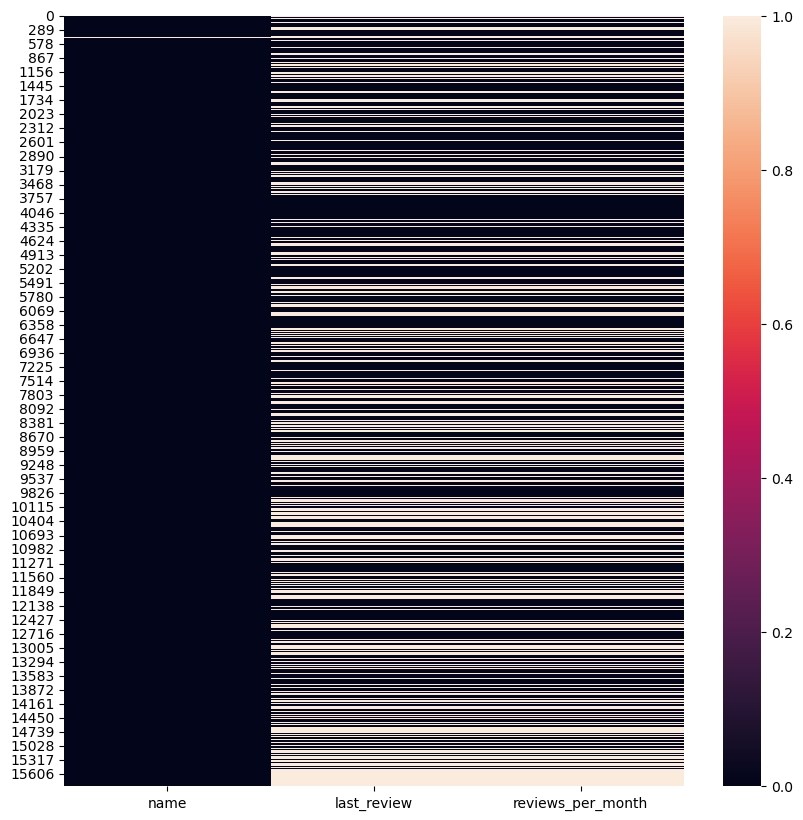

In [243]:
# Sebaran missing value di dalam data
plt.figure(figsize=(10,10))
sns.heatmap(df[['name','last_review','reviews_per_month']].isna())

Secara garis besar: 
* *missing value* di kolom `name` memiliki proporsi yang rendah (<10%), dengan missing value hanya 0.05% 
* *missing value* di kolom `last_review` dan `reviews_per_month` memiliki proporsi yang cukup tinggi (>10%), dengan missing value mencapai 36.52%.
* *missing value* di kolom `last_review` dan `reviews_per_month` memiliki sebaran yang terlihat berkaitan, jika data di `last_review` kosong, maka kemungkinan besar data di `reviews_per_month` juga kosong.

Ada 2 cara untuk menangani *missing value*:
* pertama, menghapus baris/kolom yang berisi *missing value*. Cara ini tidak disarankan dalam kasus kita, karena jumlah missing value yang tergolong cukup tinggi (sampai 36%).
* kedua, mengisi data yang hilang. Cara ini lebih disarankan. Ada beberapa metode yang bisa digunakan untuk mengisi missing value, cara yang paling baik adalah dengan mengisi data yang hilang dengan nilai sebenarnya, atau sedekat mungkin dengan nilai asli. Dalam kasus ini, kita akan mencoba mengisi *missing value* secara domain knowledge atau secara statistik berkaitan dengan kolom yang memiliki *missing value*. Jika masih ada kolom yang tidak bisa diisi, barulah kita mengisi dengan angka *mean, median* atau *modus*. Menghapus data akan menjadi opsi terakhir.

Kita sudah melihat gambaran kasar anomali di dalam data kita, sekarang, mari kita lihat dan tangani tiap-tiap anomali secara lebih jauh.  

#### `last_review` dan `reviews_per_month`

Dari analisis di atas, kita sudah tau bahwa *missing value* `last_review` dan `reviews_per_month` saling berkaitan. Maka, kita akan melakukan *handling* kedua kolom ini secara bersamaan.

In [244]:
df[df['last_review'].isna()]

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
1,1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.668180,100.616740,Private room,1316,1,0,NaN,NaN,2,358,0
2,2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.752320,100.624020,Private room,800,60,0,NaN,NaN,1,365,0
4,4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.768720,100.633380,Private room,1905,1,0,NaN,NaN,3,365,0
7,7,1738669,1 chic bedroom apartment in BKK,7045870,Jiraporn,Chatu Chak,13.829250,100.567370,Entire home/apt,1461,1,0,NaN,NaN,1,365,0
14,14,959254,"Deluxe Condo, Nana, Pool/GYM/Sauna",5153476,Natcha,Khlong Toei,13.715160,100.568060,Entire home/apt,1400,30,0,NaN,NaN,1,365,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15849,15849,790465040741092826,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,94899359,Renee,Pra Wet,13.715132,100.653458,Private room,2298,28,0,NaN,NaN,1,362,0
15850,15850,790474503157243541,Euro LuxuryHotel PratunamMKt TripleBdNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753052,100.538738,Private room,1429,1,0,NaN,NaN,14,365,0
15851,15851,790475335086864240,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753169,100.538700,Private room,1214,1,0,NaN,NaN,14,365,0
15852,15852,790475546213717328,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.754789,100.538757,Private room,1214,1,0,NaN,NaN,14,365,0


In [245]:
# jumlah missing value di kolom 'company_size' dan 'company_type'
df[['last_review', 'reviews_per_month']].isna().sum()

last_review          5790
reviews_per_month    5790
dtype: int64

Terdapat 5.790 data kosong di kolom `last_review` dan `reviews_per_month`. Dikarenakan kedua kolom tersebut saling berkaitan, di mana ketika tidak ada rata-rata review per bulan di kolom `reviews_per_month` maka di kolom `last_review` juga tidak akan muncul kapan tanggal terakhir *listing* tersebut direview. Sehingga kita bisa mengubah data kosong di kolom `reviews_per_month` dengan angka `0` dan `last_review` dapat kita hapus karena tidak akan kita gunakan dalam analisis.

In [246]:
df.drop(columns=['last_review'],inplace=True)
df['reviews_per_month'] = np.where(df['reviews_per_month'].isna(), 0, df['reviews_per_month'])

In [247]:
#pengecekkan ulang data kosong
df[['reviews_per_month']].isna().sum()

reviews_per_month    0
dtype: int64

Sekarang, data kosong sudah tidak ada di kolom `reviews_per_month`.

### `name`

Selanjutnya, mari kita cek kolom `name`. Kolom `name` berisi nama *listing* yang disewakan, memiliki *missing value* sebanyak 0.05%. Jumlah ini cukup kecil dibandingkan dengan total data, sehingga bisa kita hapus saja.

In [248]:
df = df.drop(df[df['name'].isna()].index)

### `id`, `Unnamed: 0`, `availability_365`
* Kolom `id` berisikan id unik untuk tiap *listing*, sehingga tidak relevan dalam analisis dan bisa dihapus saja.
* Kolom `Unnamed: 0` hanya berisikan indek dari setiap baris. Bisa kita hapus
* Kolom `availability_365` kita tidak tahu apakah alasan listing tidak tersedia karena pemesanan atau diblok oleh *host*. Oleh karena itu, kolom ini juga dapat dihapus.

In [249]:
df.drop(columns=['id','Unnamed: 0', 'availability_365'],inplace=True)

### Outlier

### `price`

Kolom `price` memiliki nilai minimum `0`, hal ini tidak masuk akal karena tidak mungkin ada orang yang menyewakan propertinya secara gratis. Kita akan mengganti nilai tersebut dengan `central tendency` yang sesuai.

Sebelumnya kita cek `room_type` seperti apa yang terdapat nilai `0` di `price`-nya.

In [250]:
df[df['price'] == 0]

,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm
11103,Somerset Maison Asoke Bangkok,360620448,Somerset Maison Asoke,Vadhana,13.73815,100.5642,Hotel room,0,1,0,0.0,1,0


Setelah kita cek, ternyata untuk tipe kamar `Hotel room`. Mari kita lihat distribusi data kolom `price` untuk `room_type` tipe `Hotel room`

In [251]:
dfHotel = df[df['room_type'] == 'Hotel room']
dfHotel.head(1)

,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm
12,Comfy bedroom near River pier & BTS Taksin.,263049,Tor,Sathon,13.71802,100.51539,Hotel room,1862,2,208,1.44,7,0


In [252]:
# Uji Normalitas Price
statistic, pvalue = shapiro(dfHotel['price'])

if pvalue > 0.05:
    print(f'P-Value: {pvalue}. Maka, kita asumsikan data terdistribusi normal')
else: 
    print(f'P-Value: {pvalue}. Maka, kita asumsikan data tidak terdistribusi normal')

P-Value: 0.0. Maka, kita asumsikan data tidak terdistribusi normal


Dari uji normalitas menggunakan metode Shapiro-Wilk Test, nilai p-value di bawah 0.05. Sehingga kita dapat menyimpulkan bahwa variable `price` tidak terdistribusi normal, maka dari itu `median` akan kita gunakan untuk mengganti nilai 0.

In [253]:
df['price'] = np.where(df['price'] == 0, dfHotel['price'].mode()[0], df['price'])

Mari kita cek apakah nilai minimum di kolom `price` sudah terganti.

In [254]:
df.describe()

,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm
count,1.584600e+04,15846.000000,15846.000000,1.584600e+04,15846.000000,15846.000000,15846.000000,15846.000000,15846.000000
mean,1.541634e+08,13.745149,100.559899,3.218487e+03,15.299129,16.662060,0.516433,13.895999,3.483277
std,1.318804e+08,0.043043,0.050917,2.497838e+04,50.826943,40.622034,0.952926,30.276153,8.918845
min,5.892000e+04,13.527300,100.329550,2.780000e+02,1.000000,0.000000,0.000000,1.000000,0.000000
25%,3.974431e+07,13.720092,100.529690,9.000000e+02,1.000000,0.000000,0.000000,1.000000,0.000000
50%,1.224556e+08,13.738490,100.561405,1.429000e+03,1.000000,2.000000,0.090000,4.000000,0.000000
75%,2.391941e+08,13.759497,100.585148,2.429000e+03,7.000000,13.000000,0.670000,13.000000,3.000000
max,4.926659e+08,13.953540,100.923440,1.100000e+06,1125.000000,1224.000000,19.130000,228.000000,325.000000


### `minimum_nights`

Kolom `minimum_nights` memiliki *range* yang relatif luas, dengan nilai minimum 1 hari, dan maksimum 3+ tahun. Untuk tujuan analisis, kita akan membuat kategori *listing* dengan nilai `minimum_nights` kurang dari 28 hari sebagai 'Short term' dan daftar dengan nilai `minimum_nights` 28 hari ke atas sebagai 'Long term'. *Threshold* ini diperoleh dari bagian ‘Strict Long Term’ di [artikel Airbnb ini](https://www.airbnb.co.id/help/article/475#article-content).

In [255]:
def kategori_sewa(minimum_nights):
    if minimum_nights <= 28 :
        return 'Short term'
    else:
        return 'Long term'
    
# Membuat kolom baru 'stay_type' dengan nilai berdasarkan gaji
df['stay_type'] = df['minimum_nights'].apply(kategori_sewa)
df.sample(5)

,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm,stay_type
14173,Dewan Bangkok Hotel,307765558,Reservation,Phra Nakhon,13.760117,100.498366,Private room,1536,1,7,2.39,1,7,Short term
12935,Family choice 2BR in Silom&Sathorn/3m walk-BTS&MRT,267746594,Windy,Bang Rak,13.725860,100.534300,Entire home/apt,2553,40,0,0.00,37,0,Long term
8426,New Suanmali hotel,275484995,Steve,Taling Chan,13.777660,100.457260,Entire home/apt,15493,1,0,0.00,1,0,Short term
15514,Paragon city center siam 1Br,6598548,Amornsukh,Ratchathewi,13.751550,100.535560,Entire home/apt,960,30,0,0.00,16,0,Long term
10020,"New condo in Thonglor, easy transport. City life !",279032999,Patty,Huai Khwang,13.744990,100.583760,Entire home/apt,1500,3,1,1.00,2,1,Short term


## Data yang sudah bersih
Kita sudah selesai membersihkan data kita, sekarang, mari kita lihat sekilas informasi dari data yang sudah kita bersihkan

In [256]:
listItem = []
for col in df.columns :
    listItem.append([col, df[col].dtype, df[col].isna().sum(),
                    df[col].nunique(), list(df[col].drop_duplicates().sample(2).values)]);

dfDesc = pd.DataFrame(columns=['dataFeatures', 'dataType', 'null', 'unique', 'uniqueSample'],
                     data=listItem)
print(df.shape)
dfDesc

(15846, 14)


,dataFeatures,dataType,null,unique,uniqueSample
0,name,object,0,14794,"[16+ Super Comfy Capsule Beds | Sukhumvit | Bangkok, 705★Nara Suite Residence★2KingBed+Kitchen会说中文]"
1,host_id,int64,0,6652,"[103302043, 219991682]"
2,host_name,object,0,5307,"[Grand Mercure Bangkok Atrium, Ian]"
3,neighbourhood,object,0,50,"[Bang Khun thain, Chatu Chak]"
4,latitude,float64,0,9603,"[13.71083, 13.76724]"
5,longitude,float64,0,10223,"[100.56298, 100.56597]"
6,room_type,object,0,4,"[Private room, Shared room]"
7,price,int64,0,3039,"[444, 1947]"
8,minimum_nights,int64,0,86,"[40, 183]"
9,number_of_reviews,int64,0,298,"[225, 194]"


Sebelum dibersihkan, kita memiliki 15,854 baris data, sekarang kita memiliki 15,846 baris. Sekitar 8 baris data yang kosong dihapus, dan sisa data kosong diisi dengan data yang dirasa relevan.

# Data Analysis
Setelah melakukan tahap _data cleaning_, kita bisa mulai melakukan analisis untuk mencari tahu **bagaimana karakteristik _listing_ yang populer dan tidak populer**.  

Analisis akan dilakukan dengan membandingkan data rata-rata ulasan per bulan (`reviews_per_month`) sebagai kriteria yang paling sesuai. Mari kita klasifikasikan nilai `reviews_per_month` yang melebihi _upper bound_ IQR sebagai _listing_ `popular` dan lainnya sebagai `unpopular`, kita masukkan ke dalam kolom baru bernama `popularity`.

In [257]:
Q1 = df['reviews_per_month'].quantile(0.25)
Q3 = df['reviews_per_month'].quantile(0.75)
IQR = Q3 - Q1
print(f'Nilai Q1 adalah {Q1}')
print(f'Nilai Q3 adalah {Q3}')
print(f'Nilai IQR adalah {IQR}')

Nilai Q1 adalah 0.0
Nilai Q3 adalah 0.67
Nilai IQR adalah 0.67


In [258]:
upper_bound =  Q3 + (1.5 * IQR)

def kategori_listing(review_per_month):
    if review_per_month > upper_bound:
        return 'popular'
    else:
        return 'unpopular'

df['popularity'] = df['reviews_per_month'].apply(kategori_listing)

Selanjutnya kita bagi dataset kita menjadi 2 bagian, yaitu untuk dataset yang `popular` dan `unpopular`.

In [259]:
upper_bound =  Q3 + (1.5 * IQR)

dfPopular = df[df['reviews_per_month'] > upper_bound]
dfUnpopular = df[df['reviews_per_month'] <= upper_bound]

display(dfPopular.head(), dfUnpopular.head())

,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm,stay_type,popularity
19,The Duplex - Asoke- Luxury 92sqm,9407280,Timo,Vadhana,13.74668,100.56137,Entire home/apt,5034,21,287,2.59,1,3,Short term,popular
41,❂☀☀☀Perfect Escape☀☀☀Sunny Roof EnSuite☀☀☀☀,1927968,Evan,Sathon,13.72062,100.54707,Entire home/apt,1200,1,419,3.77,37,1,Short term,popular
46,☞✪✪✪✪Roomy Studio 4 Family r friends✪No Stairs✪✪✪✪,8214044,Evan From Sanctuary House,Sathon,13.72073,100.54690,Entire home/apt,1450,1,268,2.59,8,7,Short term,popular
47,☞Downtown Central Studio-Bangkok MRT,8214044,Evan From Sanctuary House,Sathon,13.72063,100.54694,Entire home/apt,1200,1,310,3.00,8,9,Short term,popular
53,"♡Chic Studio, Easy Walk to Pier & BTS Taksin♡",3346331,Bee,Sathon,13.71192,100.51535,Entire home/apt,866,2,472,4.02,7,29,Short term,popular


,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm,stay_type,popularity
0,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.75983,100.54134,Entire home/apt,1905,3,65,0.50,2,0,Short term,unpopular
1,"Easy going landlord,easy place",120541,Emy,Bang Na,13.66818,100.61674,Private room,1316,1,0,0.00,2,0,Short term,unpopular
2,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75232,100.62402,Private room,800,60,0,0.00,1,0,Long term,unpopular
3,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.78823,100.57256,Private room,1286,7,2,0.03,1,1,Short term,unpopular
4,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.76872,100.63338,Private room,1905,1,0,0.00,3,0,Short term,unpopular


1. Dataset `popular`

In [260]:
display(dfPopular.describe(), dfPopular.describe(include='object'))

,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm
count,1.471000e+03,1471.000000,1471.000000,1471.000000,1471.000000,1471.000000,1471.000000,1471.000000,1471.000000
mean,1.430302e+08,13.740754,100.556828,2202.146159,4.974847,76.959211,2.827988,22.394969,17.431679
std,1.376029e+08,0.030605,0.036466,1792.665082,32.267421,97.247113,1.493970,37.042901,20.729992
min,1.323220e+05,13.659880,100.407700,346.000000,1.000000,2.000000,1.680000,1.000000,0.000000
25%,3.098971e+07,13.722620,100.537300,1137.500000,1.000000,8.000000,2.000000,4.000000,5.000000
50%,8.982047e+07,13.736780,100.558810,1690.000000,1.000000,26.000000,2.400000,10.000000,12.000000
75%,2.277844e+08,13.752425,100.571043,2580.000000,2.000000,127.500000,3.120000,29.000000,24.000000
max,4.893116e+08,13.926600,100.778410,22536.000000,1125.000000,1224.000000,19.130000,228.000000,325.000000


,name,host_name,neighbourhood,room_type,stay_type,popularity
count,1471,1471,1471,1471,1471,1471
unique,1392,528,37,4,2,1
top,New! Gateway/ Bangkok University 1BR 2PPL near BTS,Mike,Khlong Toei,Entire home/apt,Short term,popular
freq,15,40,381,1179,1418,1471


Dari tabel `popular` tersebut kita dapat menyimpulkan bahwa:
1. Kolom `host_id` memiliki 1.471 baris data.
2. Kolom `latitude` memiliki 1.471 baris data dengan nilai minimal 13,659880 dan maksimal 13,92660. Q1-nya adalah 13,722620, median 13,736780, dan Q3-nya adalah 13,752425. Rata-ratanya adalah 13,740754 dengan standard deviasi 0,030605.
3. Kolom `longitude` memiliki 1.471 baris data dengan nilai minimal 100,407700 dan maksimal 100,778410. Q1-nya adalah 100,537300, median 100,558810, dan Q3-nya adalah 100,571043. Rata-ratanya adalah 100,556828 dengan standard deviasi 0,036466.
4. Kolom `price` memiliki 1.471 baris data dengan nilai minimal 346 dan maksimal 22.536. Q1-nya adalah 1.137,5 , median 1.690, dan Q3-nya adalah 2.580. Rata-ratanya adalah 2.202,146159 dengan standard deviasi 1.792,665082.
5. Kolom `minimum_nights` memiliki 1.471 baris data dengan nilai minimal 1 dan maksimal 1.125. Q1-nya adalah 1, median 1, dan Q3-nya adalah 2. Rata-ratanya adalah 4,974847 dengan standard deviasi 32,267421.
6. Kolom `number_of_reviews` memiliki 1.471 baris data dengan nilai minimal 2 dan maksimal 1.224. Q1-nya adalah 8, median 26, dan Q3-nya adalah 127,5. Rata-ratanya adalah 76,959211 dengan standard deviasi 97,247113.
7. Kolom `reviews_per_month` memiliki 1.471 baris data dengan nilai minimal 1,68 dan maksimal 19,13. Q1-nya adalah 2, median 2,4 dan Q3-nya adalah 3,12. Rata-ratanya adalah 2,827988 dengan standard deviasi 1,493970.
8. Kolom `calculated_host_listings_count` memiliki 1.471 baris data dengan nilai minimal 1 dan maksimal 228. Q1-nya adalah 4, median 10, dan Q3-nya adalah 29. Rata-ratanya adalah 22,394969 dengan standard deviasi 37,042901.
9. Kolom `number_of_reviews_ltm` memiliki 1.471 baris data dengan nilai minimal 0 dan maksimal 325. Q1-nya adalah 5, median 12, dan Q3-nya adalah 24. Rata-ratanya adalah 17,431679 dengan standard deviasi 20,729992.
10. Kolom `name` memiliki 1.471 baris data nilai unique 1392. Nilai yang sering muncul adalah `New! Gateway/ Bangkok University 1BR 2PPL near BTS` dengan frekuensi 15 kali kemunculan.
11. Kolom `host_name` memiliki 1.471 baris data nilai unique 528. Nilai yang sering muncul adalah `Mike` dengan frekuensi 40 kali kemunculan.
12. Kolom `neighbourhood` memiliki 1.471 baris data nilai unique 37. Nilai yang sering muncul adalah `Khlong Toei` dengan frekuensi 381 kali kemunculan.
13. Kolom `room_type` memiliki 1.471 baris data nilai unique 4. Nilai yang sering muncul adalah `Entire home/apt` dengan frekuensi 1.179 kali kemunculan.
14. Kolom `stay_type` memiliki 1.471 baris data nilai unique 2. Nilai yang sering muncul adalah `Short term` dengan frekuensi 1.418 kali kemunculan.
12. Kolom `popularity` memiliki 1.471 baris data nilai unique 1. Nilai yang sering muncul adalah `popular` dengan frekuensi 1.471 kali kemunculan.


2. Dataset `unpopular`

In [261]:
display(dfUnpopular.describe(), dfUnpopular.describe(include='object'))

,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,number_of_reviews_ltm
count,1.437500e+04,14375.000000,14375.000000,1.437500e+04,14375.000000,14375.000000,14375.000000,14375.000000,14375.000000
mean,1.553027e+08,13.745599,100.560214,3.322490e+03,16.355617,10.491826,0.279890,13.026296,2.055930
std,1.312324e+08,0.044095,0.052161,2.621688e+04,52.242226,21.017271,0.412269,29.359401,4.668018
min,5.892000e+04,13.527300,100.329550,2.780000e+02,1.000000,0.000000,0.000000,1.000000,0.000000
25%,4.069578e+07,13.719600,100.528955,8.915000e+02,1.000000,0.000000,0.000000,1.000000,0.000000
50%,1.241941e+08,13.738830,100.562120,1.400000e+03,1.000000,1.000000,0.050000,4.000000,0.000000
75%,2.403435e+08,13.760480,100.586479,2.414000e+03,9.000000,10.000000,0.430000,12.000000,2.000000
max,4.926659e+08,13.953540,100.923440,1.100000e+06,1115.000000,212.000000,1.670000,228.000000,56.000000


,name,host_name,neighbourhood,room_type,stay_type,popularity
count,14375,14375,14375,14375,14375,14375
unique,13472,5168,50,4,2,1
top,New! La Chada Night Market studio 2PPL near MRT,Curry,Vadhana,Entire home/apt,Short term,unpopular
freq,45,193,1873,7732,12132,14375


Dari tabel `unpopular` tersebut kita dapat menyimpulkan bahwa:
1. Kolom `host_id` memiliki 14.375 baris data.
2. Kolom `latitude` memiliki 14.375 baris data dengan nilai minimal 13,527300 dan maksimal 13,953540. Q1-nya adalah 13,719600, median 13,738830, dan Q3-nya adalah 13,760480. Rata-ratanya adalah 13,745599 dengan standard deviasi 0,044095.
3. Kolom `longitude` memiliki 14.375 baris data dengan nilai minimal 100,329550 dan maksimal 100,923440. Q1-nya adalah 100,528955, median 100,562120, dan Q3-nya adalah 100,586479. Rata-ratanya adalah 100,560214 dengan standard deviasi 0,052161.
4. Kolom `price` memiliki 14.375 baris data dengan nilai minimal 278 dan maksimal 1.100.000. Q1-nya adalah 891,5 , median 1.400, dan Q3-nya adalah 2.414. Rata-ratanya adalah 3.322,49 dengan standard deviasi 26.216,88.
5. Kolom `minimum_nights` memiliki 14.375 baris data dengan nilai minimal 1 dan maksimal 1.115. Q1-nya adalah 1, median 1, dan Q3-nya adalah 9. Rata-ratanya adalah 16,355617 dengan standard deviasi 52,242226	.
6. Kolom `number_of_reviews` memiliki 14.375 baris data dengan nilai minimal 0 dan maksimal 212. Q1-nya adalah 0, median 1, dan Q3-nya adalah 10. Rata-ratanya adalah 10,491826 dengan standard deviasi 21,017271.
7. Kolom `reviews_per_month` memiliki 14.375 baris data dengan nilai minimal 0 dan maksimal 1,67. Q1-nya adalah 0, median 0,05 dan Q3-nya adalah 0,43. Rata-ratanya adalah 0,279890	 dengan standard deviasi 0,412269.
8. Kolom `calculated_host_listings_count` memiliki 14.375 baris data dengan nilai minimal 1 dan maksimal 228. Q1-nya adalah 1, median 4, dan Q3-nya adalah 12. Rata-ratanya adalah 13,026296 dengan standard deviasi 29,359401.
9. Kolom `number_of_reviews_ltm` memiliki 14.375 baris data dengan nilai minimal 0 dan maksimal 56. Q1-nya adalah 0, median 0, dan Q3-nya adalah 2. Rata-ratanya adalah 2,055930 dengan standard deviasi 4,668018.
10. Kolom `name` memiliki 14.375 baris data nilai unique 13.472. Nilai yang sering muncul adalah `New! La Chada Night Market studio 2PPL near MRT	` dengan frekuensi 45 kali kemunculan.
11. Kolom `host_name` memiliki 14.375 baris data nilai unique 5.168. Nilai yang sering muncul adalah `Curry` dengan frekuensi 193 kali kemunculan.
12. Kolom `neighbourhood` memiliki 14.375 baris data nilai unique 50. Nilai yang sering muncul adalah `Vadhana` dengan frekuensi 1.873 kali kemunculan.
13. Kolom `room_type` memiliki 14.375 baris data nilai unique 4. Nilai yang sering muncul adalah `Entire home/apt` dengan frekuensi 7.732 kali kemunculan.
14. Kolom `stay_type` memiliki 14.375 baris data nilai unique 2. Nilai yang sering muncul adalah `Short term` dengan frekuensi 12.132 kali kemunculan.
15. Kolom `popularity` memiliki 14.375 baris data nilai unique 1. Nilai yang sering muncul adalah `unpopular` dengan frekuensi 14.375 kali kemunculan.


## Berdasarkan jenis kamar: `room_type`

Pertama kita akan menganalisis berdasakan tipe kamar. Tipe kamar apa saja yang ada di Airbnb Bangkok.

1. Popular Listing

In [262]:
# Menghitung persentase per tipe kamar
srcPopular = dfPopular['room_type'].value_counts(normalize=True).to_frame().reset_index()
srcPopular.rename(columns={'index': 'room_type', 'room_type':'pct',}, inplace=True)
display(srcPopular)

,room_type,pct
0,Entire home/apt,0.801496
1,Private room,0.174711
2,Hotel room,0.021074
3,Shared room,0.002719


In [263]:
# Set color
color_scale = alt.Scale(
    domain=['Entire home/apt', 'Private room', 'Hotel room', 'Shared room'],
    range=['#fb8f18', '#ee6065', '#0ca484', 'blue'])

values = [200, 220, 240, 260]
# Membuat basis grafik
base = alt.Chart(srcPopular).encode(
    alt.Theta("pct").stack(True),
    alt.Color("room_type")
        .title(None)
        .scale(color_scale)
        .legend(orient='none', legendX=300, legendY=80),
)

# Membuat pie chart
pie = base.mark_arc(outerRadius=120, innerRadius=50, stroke='#fff')

# Membuat teks persentase
pct = base.mark_text(radius=150, size=15).encode(
    text=alt.Text('pct', format='.2%'),)

# Membuat teks total listing
annotation = base.mark_text(
    text=['1,471', "Listing"],
    align='center',
    font='Calibri',
    fontSize=25,
    dy=-20,
)
# Menggabungkan chart dengan teks
(pie + pct + annotation).properties(
    title=alt.Title(
        "Kamar Bertipe 'Entire home/apt' Mendominasi Populasi Popular Listing Airbnb Bangkok",
        subtitle='Persentase Tipe Kamar Listing Popular',
        anchor='start',
        font='Calibri',
        fontSize=18,
        offset=20,
    ),
    width=300, height=300
)

alt.LayerChart(...)

2. Unpopular Listing

In [264]:
# Menghitung persentase per tipe kamar
srcUnpopular = dfUnpopular['room_type'].value_counts(normalize=True).to_frame().reset_index()
srcUnpopular.rename(columns={'index': 'room_type', 'room_type':'pct',}, inplace=True)
display(srcUnpopular)

,room_type,pct
0,Entire home/apt,0.537878
1,Private room,0.383026
2,Hotel room,0.042991
3,Shared room,0.036104


In [265]:
# Set color
color_scale = alt.Scale(
    domain=['Entire home/apt', 'Private room', 'Hotel room', 'Shared room'],
    range=['#fb8f18', '#ee6065', '#0ca484', 'blue']
)

values = [200, 220, 240, 260]
# Membuat basis grafik
base = alt.Chart(srcUnpopular).encode(
    alt.Theta("pct").stack(True),
    alt.Color("room_type")
        .title(None)
        .scale(color_scale)
        .legend(orient='none', legendX=300, legendY=80),
)

# Membuat pie chart
pie = base.mark_arc(outerRadius=120, innerRadius=50, stroke='#fff')

# Membuat teks persentase
pct = base.mark_text(radius=150, size=15).encode(
    text=alt.Text('pct', format='.2%'),)

# Membuat teks total listing
annotation = base.mark_text(
    text=['14,375', "Listing"],
    align='center',
    font='Calibri',
    fontSize=25,
    dy=-20,
)
# Menggabungkan chart dengan teks
(pie + pct + annotation).properties(
    title=alt.Title(
        "Kamar Bertipe 'Entire home/apt' Mendominasi Populasi Unpopular Listing Airbnb Bangkok",
        subtitle='Persentase Tipe Kamar Listing Unpopular',
        anchor='start',
        font='Calibri',
        fontSize=18,
        offset=20,
    ),
    width=300, height=300
)

alt.LayerChart(...)

Grafik di atas, baik yang `popular` maupun `unpopular` menunjukkan bahwa lebih dari 50% populasi Listing Airbnb yang ada di Kota Bangkok, Thailand didominasi oleh kamar bertipe `Entire home/apt`. Namun hal ini belum menunjukkan apakah dominasi tersebut menjadikannya tipe kamar yang paling diminati konsumen. Maka dari itu kita analisis lebih lanjut.

Sebelum itu, mari kita cek distribusi dari kolom `reviews_per_month` terlebih dahulu.

<Axes: >

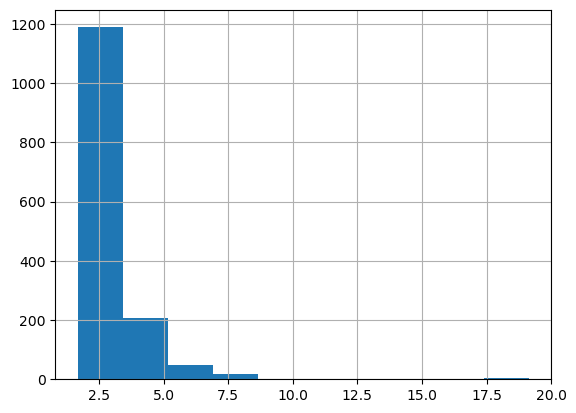

In [266]:
# Popular Listing
dfPopular['reviews_per_month'].hist()

<Axes: >

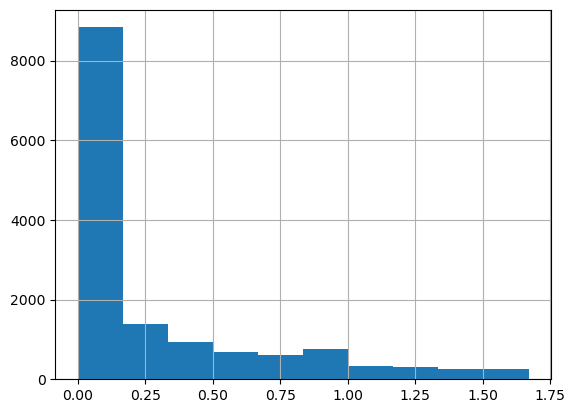

In [267]:
# Unpopular Listing
dfUnpopular['reviews_per_month'].hist()

Grafik di atas jelas menunjukkan bahwa data di kolom `reviews_per_month` tidak terdistribusi dengan normal. Maka dari itu kita akan gunakan median sebagai _central tendency_-nya sebagai acuan popularitas dari setiap tipe kamar. 

In [268]:
# Popular
crosstab_result_pop = pd.crosstab(dfPopular['room_type'], columns='reviews_per_month', values=dfPopular['reviews_per_month'], aggfunc='median')

# Tampilkan hasil
crosstab_result_pop.reset_index()

col_0,room_type,reviews_per_month
0,Entire home/apt,2.40
1,Hotel room,2.45
2,Private room,2.36
3,Shared room,1.94


In [269]:
sourcePop = crosstab_result_pop.reset_index()

alt.Chart(sourcePop).mark_bar().encode(
    alt.X('room_type', title='Tipe Kamar', axis=alt.Axis(labelAngle=0)),
    alt.Y("reviews_per_month", title= 'Review per Bulan'),
    # The highlight will be set on the result of a conditional statement
    color=alt.Color("room_type")
        .title(None)
        .scale(color_scale)
        .legend(None),

).properties(width=600,
             title=alt.Title(
        "Konsumen Airbnb Lebih Memilih Kamar yang Memiliki Privasi Tinggi",
        subtitle='Perbandingan Tipe Kamar Popular Listing Berdasarkan Review per Bulan',
        anchor='start',
        font='Calibri',
        fontSize=18,
        offset=20,
    ))

alt.Chart(...)

Dari grafik di atas, kita dapat melihat untuk yang `popular` hampir semua tipe kamar menjadi pilihan konsumen kecuali yang bertipe `Shared room`. Hal ini dapat disimpulkan bahwa konsumen lebih memilih kamar yang dapat menjaga privasi.

In [270]:
# Unpopular
crosstab_result_unpop = pd.crosstab(dfUnpopular['room_type'], columns='reviews_per_month', values=dfUnpopular['reviews_per_month'], aggfunc='median')

# Tampilkan hasil
crosstab_result_unpop.reset_index()

col_0,room_type,reviews_per_month
0,Entire home/apt,0.190
1,Hotel room,0.045
2,Private room,0.000
3,Shared room,0.000


In [271]:
sourceUnpop = crosstab_result_unpop.reset_index()

alt.Chart(sourceUnpop).mark_bar().encode(
    alt.X('room_type',  title='Tipe Kamar', axis=alt.Axis(labelAngle=0)),
    alt.Y("reviews_per_month", title= 'Review per Bulan'), # ini ganti review per month

    color=alt.Color("room_type")
        .title(None)
        .scale(color_scale)
        .legend(None),

).properties(width=600,
             title=alt.Title(
        "Konsumen Airbnb Lebih Memilih Kamar yang Memiliki Privasi Tinggi",
        subtitle='Perbandingan Tipe Kamar Unpopular Listing Berdasarkan Review per Bulan',
        anchor='start',
        font='Calibri',
        fontSize=18,
        offset=20,
    ))

alt.Chart(...)

Kemudian untuk yang `unpopular`, kamar bertipe `Entire home/apt` dan `Hotel room` menjadi pilihan utama konsumen. Tetapi, untuk yang `Private room` dan `Shared room` bukan menjadi tujuan utama bagi konsumen. Mari kita analisis lebih lanjut dari segi harganya untuk masing-masing tipe kamar.

## Berdasarkan harga sewa: `price`  

Pertama, mari kita lihat bagaimana pengaruh harga sewa terhadap minat wisatawan untuk menginap. Sebelum itu, kita lihat distribusi data dari `price`.

In [272]:
alt.Chart(dfPopular).mark_bar().encode(
    x=alt.X("price").bin(maxbins=100),
    y=alt.Y('count()', title='Frekuensi')
).properties(
    width=500,
    height=250,
    title= 'Distribusi Harga Popular Listing'
)

alt.Chart(...)

In [273]:
alt.Chart(dfUnpopular).mark_bar().encode(
    x=alt.X("price").bin(maxbins=100),
    y=alt.Y('count()', title='Frekuensi')
).properties(
    width=500,
    height=250,
    title= 'Distribusi Harga Unpopular Listing'
)

alt.Chart(...)

Dari kedua grafik di atas menunjukkan bahwa baik yang `popular` maupun `unpopular`, distribusi harganya tidak normal. Maka, kita akan menggunakan Median sebagai ukuran pemusatannya. Mari kita cek median dan range harga dari masing-masing kategori popularitas (`popular` dan `unpopular`).

1. Popular Listing

In [274]:
def median_absolute_deviation(data):
    median = np.median(data)
    absolute_deviations = np.abs(data - median)
    mad = np.median(absolute_deviations)
    return mad

# Contoh penggunaan
data = dfPopular['price']
mad_result = median_absolute_deviation(data)
print("Median price Unpopular:", dfPopular['price'].median())
print("Median Absolute Deviation (MAD):", mad_result)

Median price Unpopular: 1690.0
Median Absolute Deviation (MAD): 667.0


* Median Harga Popular Listing: 1690 dengan deviasi 667
* Dengan ini kita dapat menyimpulkan bahwa _range_ harga `popular` listing berada di antara 1023 dan 2357

2. Unpopular Listing

In [275]:
def median_absolute_deviation(data):
    median = np.median(data)
    absolute_deviations = np.abs(data - median)
    mad = np.median(absolute_deviations)
    return mad

# Contoh penggunaan
data = dfUnpopular['price']
mad_result = median_absolute_deviation(data)
print("Median price Unpopular:", dfUnpopular['price'].median())
print("Median Absolute Deviation (MAD):", mad_result)

Median price Unpopular: 1400.0
Median Absolute Deviation (MAD): 600.0


* Median Harga Unpopular Listing: 1400 dengan deviasi 600
* Dengan ini kita dapat menyimpulkan bahwa _range_ harga `unpopular` listing berada di antara 800 dan 2000

Visualisai perbandingan median `popular` dan `unpopular` listing.

In [276]:
def median_absolute_deviation(arr):
    median = np.median(arr)
    deviations = np.abs(arr - median)
    return np.median(deviations)

# Fungsi untuk menghitung lower bound dan upper bound
def calculate_bounds(median, mad):
    lower_bound = median - mad
    upper_bound = median + mad
    return lower_bound, upper_bound


# Menghitung median dan MAD untuk setiap tetangga
median_prices = df.groupby('popularity')['price'].median()
mad_prices = df.groupby('popularity')['price'].apply(median_absolute_deviation)

# Menghitung lower bound dan upper bound berdasarkan MAD
lower_bounds, upper_bounds = calculate_bounds(median_prices, mad_prices)

# Membuat DataFrame baru
bounds_df = pd.DataFrame({'popularity': median_prices.index,
                          'median': median_prices.values,
                          'lower_bound': lower_bounds,
                          'upper_bound': upper_bounds})

# Menampilkan DataFrame baru
bounds_df = bounds_df.reset_index(drop=True)
bounds_df

,popularity,median,lower_bound,upper_bound
0,popular,1690.0,1023.0,2357.0
1,unpopular,1400.0,800.0,2000.0


In [277]:
# Membuat chart Altair
chart = alt.Chart(data=bounds_df)

# Garis untuk nilai median
line = chart.mark_line(color='#db646f').encode(
    x=alt.X('median:Q', title ='price (Baht)'),
    y='popularity:N',
    detail='popularity:N'
).properties(title=alt.Title(
        "Popular Listing Lebih Mahal Daripada Unpopular Listing",
        subtitle='Range Harga Popular dan Unpopular Listing',
        anchor='start',
        font='Calibri',
        fontSize=18,
        offset=20,
    ))

# Titik untuk menandai nilai median
points = chart.mark_point(
    size=100,
    opacity=1,
    filled=True
).encode(
    x='median:Q',
    y='popularity:N',
    color=alt.Color('popularity:N', scale=alt.Scale(domain=['popular', 'unpopular'], range=['#03A9F4', '#E57373']))
)

# Garis untuk nilai minimum dan maksimum
errorbars = chart.mark_rule().encode(
    x='lower_bound:Q',
    x2='upper_bound:Q',
    y='popularity:N',
    color=alt.Color('popularity:N', scale=alt.Scale(domain=['popular', 'unpopular'], range=['#03A9F4', '#E57373'])).legend(None)
)

# Gabungkan semua layer
chart = (line + points + errorbars).properties(width = 400, height = 100)

chart

alt.LayerChart(...)

Dari visualisai di atas dapat disimpulkan bahwa `popular` listing memiliki harga yang lebih tinggi daripada `unpopular` listing. Popular listing memiliki median harga di 1690 dengan range antara 1023 - 2357, sedangkan `unpopular` listing memiliki median harga yang lebih rendah dengan range antara 800 - 2000. Maka kita dapat menyimpulkan bahwa konsumen lebih memilih harga yang lebih tinggi untuk mendapatkan fasilitas yang lebih baik.

## Berdasarkan sebaran tipe kamar: `room_type`, `longitude`, `latitude`  


Setelah mengetahui harga dari _listing_ `popular` dan `unpopular`, sekarang kita lihat dari sebaran daerahnya.

In [278]:
import json

# Load peta Bangkok
with open('bangkok.geojson') as f:
    bangkok_geojson = json.load(f)

# Load district di Bangkok
with open('neighbourhoods.geojson') as g:
    bangkok_district_geojson = json.load(g)

1. Popular Listing

In [279]:
def add_legend(map_obj):
    legend_html = '''
        <div style="position: fixed; 
                    bottom: 50px; right: 50px; width: 140px; height: 70px; 
                    border:2px solid grey; z-index:9999; font-size:14px;
                    ">&nbsp; <b>Legend</b> <br>
                      &nbsp; Popular &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:#03A9F4"></i><br>
        </div>
        '''
    map_obj.get_root().html.add_child(folium.Element(legend_html))

# Inisialisasi peta
m = folium.Map(location=[13.7563, 100.5018], zoom_start=10.8, tiles='cartodbpositron', scrollWheelZoom=False, zoom_control=True)

# Tambahkan batas distrik Bangkok
folium.GeoJson(bangkok_geojson, name='bangkok.geojson', style_function=lambda x: {'color': '#89cffO', 'weight': 1}).add_to(m)

# Tambahkan batas-batas distrik
folium.GeoJson(bangkok_district_geojson, name='neighbourhoods.geojson', style_function=lambda x: {'color': 'red', 'weight': 1, 'fillColor': '#89cffO', 'fillOpacity': 0.2}).add_to(m)

# Add points to the map for popular listings
for index, row in df.iterrows():
    if row['popularity'] == 'popular':
        color = '#03A9F4'
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=5,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.8,  # Higher opacity for popular listings
            popup=row['name']
        ).add_to(m)


# Tampilkan judul utama
title_html = """
             <h3 align="center" style="font-size:20px"><b>Popular Listing Tersebar di Pusat Kota Bangkok</b></h3>
             """
m.get_root().html.add_child(folium.Element(title_html))

# Tampilkan subtitle
subtitle_html = """
             <h4 align="center" style="font-size:16px"><i>Sebaran Geografi Listing Popular Airbnb Bangkok</i></h4>
             """
m.get_root().html.add_child(folium.Element(subtitle_html))

# Tampilkan legenda
add_legend(m)

m


2. Unpopular Listing

In [280]:
def add_legend(map_obj):
    legend_html = '''
        <div style="position: fixed; 
                    bottom: 50px; right: 50px; width: 140px; height: 70px; 
                    border:2px solid grey; z-index:9999; font-size:14px;
                    ">&nbsp; <b>Legend</b> <br>
                      &nbsp; Unpopular &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:#E57373"></i><br>
        </div>
        '''
    map_obj.get_root().html.add_child(folium.Element(legend_html))

# Inisialisasi peta
m = folium.Map(location=[13.7563, 100.5018], zoom_start=10.8, tiles='cartodbpositron', scrollWheelZoom=False, zoom_control=True)

# Tambahkan batas distrik Bangkok
folium.GeoJson(bangkok_geojson, name='bangkok.geojson', style_function=lambda x: {'color': '#89cffO', 'weight': 1}).add_to(m)

# Tambahkan batas-batas distrik
folium.GeoJson(bangkok_district_geojson, name='neighbourhoods.geojson', style_function=lambda x: {'color': 'red', 'weight': 1, 'fillColor': '#89cffO', 'fillOpacity': 0.2}).add_to(m)

# Add points to the map for popular listings
for index, row in df.iterrows():
    if row['popularity'] == 'unpopular':
        color = '#E57373'
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=5,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.8,  # Higher opacity for popular listings
            popup=row['name']
        ).add_to(m)


# Tampilkan judul
title_html = """
             <h3 align="center" style="font-size:20px"><b>Unpopular Listing Tersebar Hampir ke Penjuru Kota Bangkok</b></h3>
             """
m.get_root().html.add_child(folium.Element(title_html))

# Tampilkan subtitle
subtitle_html = """
             <h4 align="center" style="font-size:16px"><i>Sebaran Geografi Listing Unpopular Airbnb Bangkok</i></h4>
             """
m.get_root().html.add_child(folium.Element(subtitle_html))

# Tampilkan legenda
add_legend(m)

m


Dari kedua peta dia atas, kita dapat melihat untuk _listing_ `popular` tersebar di pusat kota Bangkok. Sedangkan untuk _listing_ `unpopular` tersebar di daerah Bangkok bagian tengah. Berikut beberapa distrik yang ada di pusat kota Bangkok:
1. Phaya Thai
2. Bang Kapi
3. Huai Khwang
4. Vadhana
5. Khlong Toei
6. Sathon
7. Dusit
8. Pathum Wan
9. Thon Buri
10. Ratchathewi

Lantas apa yang membuat konsumen lebih memilih _listing_ tertentu untuk menginap sehingga menjadikan _listing_ tersebut popular? Mari lanjutkan analisis kita.



## Berdasarkan wilayah sekitar: `neighbourhood`  

Pada bagian ini kita akan menganalisis wilayah mana saja yang menjadi favorit konsumen untuk menginap. Untuk mempermudah analisis kita gunakan kolom `number_of_review` sebagai acuan. Kita akan menggunakan dataset `popular`.

In [281]:
popular_neigh = dfPopular.groupby('neighbourhood')['number_of_reviews'].sum()
top_popular_neigh = pd.DataFrame(popular_neigh).reset_index().sort_values(by='number_of_reviews', ascending=False).head(5)
top_popular_neigh

,neighbourhood,number_of_reviews
19,Khlong Toei,19894
35,Vadhana,16393
32,Sathon,11544
7,Bang Rak,8667
30,Ratchathewi,7779


In [282]:
source = top_popular_neigh

base = alt.Chart(source).encode(
    x='number_of_reviews',
    y=alt.Y('neighbourhood', sort='-x'),
    text='number_of_reviews'
)

bar = base.mark_bar().properties(width=400)
text = base.mark_text(align='left', dx=2)

(bar + text).properties(height=200,
                        title=alt.Title(
        "Khlong Toei dan Vadhana Menjadi Daerah Paling Diminati Untuk Menginap",
        subtitle='Top 5 Daerah yang Paling Diminati Wisatawan',
        anchor='start',
        font='Calibri',
        fontSize=18,
        offset=20,
    ))

alt.LayerChart(...)

Khlong Toei dan Vadhana menjadi tujuan utama untuk menginap bagi konsumen Airbnb. Mengapa hal ini bisa terjadi? Kedua _district_ ini dulunya adalah 1 _district_ yang bernama Khlong-Toei hingga pada akhirnya tahun 1989 Vadhana menjadi _district_ otonomi sendiri. Khlong Toei adalah wilayah dengan pelabuhan lautnya yang sibuk, sedangkan Vadhana terkenal karena tempat wisata dan sebagai pusat bisnis. Kedua _district_ ini menjadi tempat bagi kantor Kedutaan Besar berbagai negara.

Mari kita lihat range harga _listing_ `popular` dan `unpopular` yang berada di 5 daerah tersebut.

1. Popular

In [283]:
def median_absolute_deviation(arr):
    median = np.median(arr)
    deviations = np.abs(arr - median)
    return np.median(deviations)

# Fungsi untuk menghitung lower bound dan upper bound
def calculate_bounds(median, mad):
    lower_bound = median -mad
    upper_bound = median +mad
    return lower_bound, upper_bound

# Filter DataFrame berdasarkan tetangga
selected_neighborhoods = ['Khlong Toei', 'Vadhana', 'Sathon', 'Bang Rak', 'Ratchathewi']
filtered_df = dfPopular[dfPopular['neighbourhood'].isin(selected_neighborhoods)]

# Menghitung median dan MAD untuk setiap tetangga
median_prices = filtered_df.groupby('neighbourhood')['price'].median()
mad_prices = filtered_df.groupby('neighbourhood')['price'].apply(median_absolute_deviation)

# Menghitung lower bound dan upper bound berdasarkan MAD
lower_bounds, upper_bounds = calculate_bounds(median_prices, mad_prices)

# Membuat DataFrame baru
bounds_df = pd.DataFrame({'neighbourhood': median_prices.index,
                          'median': median_prices.values,
                          'lower_bound': lower_bounds,
                          'upper_bound': upper_bounds})

# Menampilkan DataFrame baru
bounds_df = bounds_df.reset_index(drop=True)

# Membuat dictionary untuk memetakan urutan tetangga ke indeksnya
neighborhood_order = {neighborhood: index for index, neighborhood in enumerate(selected_neighborhoods)}

# Mendapatkan indeks urutan untuk setiap tetangga
bounds_df['order'] = bounds_df['neighbourhood'].map(neighborhood_order)

# Mengurutkan DataFrame berdasarkan indeks urutan
popularprice = bounds_df.sort_values(by='order').drop('order', axis=1)

# Menampilkan DataFrame yang sudah diurutkan
popularprice = popularprice.reset_index(drop=True)
popularprice

,neighbourhood,median,lower_bound,upper_bound
0,Khlong Toei,2001.0,1502.0,2500.0
1,Vadhana,2103.0,1241.5,2964.5
2,Sathon,1146.0,836.0,1456.0
3,Bang Rak,2614.0,1347.0,3881.0
4,Ratchathewi,1571.0,1140.0,2002.0


In [284]:
# Membuat chart Altair
chart = alt.Chart(data=popularprice)

# Garis untuk nilai median
line = chart.mark_line(color='#db646f').encode(
    x=alt.X('median:Q', title ='price (Baht)'),
    y='neighbourhood:N',
    detail='neighbourhood:N'
).properties(title=alt.Title(
        "Mayoritas Popular Listing di Top 5 Neighbourhood Memiliki Harga di Atas 2000 Baht",
        subtitle='Range Harga Popular Listing di Top 5 Neighbourhood',
        anchor='start',
        font='Calibri',
        fontSize=18,
        offset=20,
    ))

# Titik untuk menandai nilai median
points = chart.mark_point(
    size=100,
    opacity=1,
    filled=True
).encode(
    x='median:Q',
    y='neighbourhood:N',
    color=alt.Color('neighbourhood:N', scale=alt.Scale(domain=['Khlong Toei', 'Vadhana', 'Sathon', 'Bang Rak', 'Ratchathewi'], range=['#03A9F4','#03A9F4','#03A9F4','#03A9F4','#03A9F4']))
)

# Garis untuk nilai minimum dan maksimum
errorbars = chart.mark_rule().encode(
    x='lower_bound:Q',
    x2='upper_bound:Q',
    y='neighbourhood:N',
    color=alt.Color('neighbourhood:N', scale=alt.Scale(domain=['Khlong Toei', 'Vadhana', 'Sathon', 'Bang Rak', 'Ratchathewi'], range=['#03A9F4','#03A9F4','#03A9F4','#03A9F4','#03A9F4'])).legend(None)
)

# Gabungkan semua layer
chart = (line + points + errorbars).properties(width = 400, height = 100)


chart


alt.LayerChart(...)

2. Unpopular

In [285]:
def median_absolute_deviation(arr):
    median = np.median(arr)
    deviations = np.abs(arr - median)
    return np.median(deviations)

# Fungsi untuk menghitung lower bound dan upper bound
def calculate_bounds(median, mad):
    lower_bound = median -mad
    upper_bound = median +mad
    return lower_bound, upper_bound

# Filter DataFrame berdasarkan tetangga
selected_neighborhoods = ['Khlong Toei', 'Vadhana', 'Sathon', 'Bang Rak', 'Ratchathewi']
filtered_df = dfUnpopular[dfUnpopular['neighbourhood'].isin(selected_neighborhoods)]

# Menghitung median dan MAD untuk setiap tetangga
median_prices = filtered_df.groupby('neighbourhood')['price'].median()
mad_prices = filtered_df.groupby('neighbourhood')['price'].apply(median_absolute_deviation)

# Menghitung lower bound dan upper bound berdasarkan MAD
lower_bounds, upper_bounds = calculate_bounds(median_prices, mad_prices)

# Membuat DataFrame baru
bounds_df = pd.DataFrame({'neighbourhood': median_prices.index,
                          'median': median_prices.values,
                          'lower_bound': lower_bounds,
                          'upper_bound': upper_bounds})

# Menampilkan DataFrame baru
bounds_df = bounds_df.reset_index(drop=True)

# Membuat dictionary untuk memetakan urutan tetangga ke indeksnya
neighborhood_order = {neighborhood: index for index, neighborhood in enumerate(selected_neighborhoods)}

# Mendapatkan indeks urutan untuk setiap tetangga
bounds_df['order'] = bounds_df['neighbourhood'].map(neighborhood_order)

# Mengurutkan DataFrame berdasarkan indeks urutan
unpopularprice = bounds_df.sort_values(by='order').drop('order', axis=1)

# Menampilkan DataFrame yang sudah diurutkan
unpopularprice= unpopularprice.reset_index(drop=True)
unpopularprice

,neighbourhood,median,lower_bound,upper_bound
0,Khlong Toei,1588.0,1000.0,2176.0
1,Vadhana,1950.0,1064.0,2836.0
2,Sathon,1350.0,900.0,1800.0
3,Bang Rak,1818.5,1000.0,2637.0
4,Ratchathewi,1529.0,1000.0,2058.0


In [286]:
# Membuat chart Altair
chart = alt.Chart(data=unpopularprice)

# Garis untuk nilai median
line = chart.mark_line(color='#db646f').encode(
    x=alt.X('median:Q', title ='price (Baht)'),
    y='neighbourhood:N',
    detail='neighbourhood:N'
).properties(title=alt.Title(
        "Semua Unopular Listing di Top 5 Neighbourhood Memiliki Harga di Bawah 2000 Baht",
        subtitle='Range Harga Unpopular Listing di Top 5 Neighbourhood',
        anchor='start',
        font='Calibri',
        fontSize=18,
        offset=20,
)
)

# Titik untuk menandai nilai median
points = chart.mark_point(
    size=100,
    opacity=1,
    filled=True
).encode(
    x='median:Q',
    y='neighbourhood:N',
    color=alt.Color('neighbourhood:N', scale=alt.Scale(domain=['Khlong Toei', 'Vadhana', 'Sathon', 'Bang Rak', 'Ratchathewi'], range=['#E57373','#E57373','#E57373','#E57373','#E57373']))
)

# Garis untuk nilai minimum dan maksimum
errorbars = chart.mark_rule().encode(
    x='lower_bound:Q',
    x2='upper_bound:Q',
    y='neighbourhood:N',
    color=alt.Color('neighbourhood:N', scale=alt.Scale(domain=['Khlong Toei', 'Vadhana', 'Sathon', 'Bang Rak', 'Ratchathewi'], range=['#E57373','#E57373','#E57373','#E57373','#E57373'])).legend(None)
)

# Gabungkan semua layer
chart = (line + points + errorbars).properties(width = 400, height = 100)


chart


alt.LayerChart(...)

Jika dibandingkan harga di Top 5 Daerah pilihan konsumen, _listing_ `popular` memiliki harga yang lebih tinggi dibandingkan _listing_ `unpopular`. Hal ini semakin menguatkan analisis kita di atas berdasarkan `price` bahwa konsumen tidak masalah membayar lebih mahal untuk mendapatkan kenyamanan dan fasilitas yang lebih baik.

## Berdasarkan Minimal Jangka Sewa: `stay_type`

1. Popular Listing

In [287]:
# Popular
stayPopular = pd.crosstab(dfPopular['stay_type'], columns='reviews_per_month', values=dfPopular['reviews_per_month'], aggfunc='median')

# Tampilkan hasil
stayPopular.reset_index()

col_0,stay_type,reviews_per_month
0,Long term,2.19
1,Short term,2.41


In [288]:
sourcePop = stayPopular.reset_index()

# Set color
color_scale = alt.Scale(
    domain=['Long term', 'Short term'],
    range=['#CFF800', '#FFD872'])

alt.Chart(sourcePop).mark_bar().encode(
    alt.X('stay_type',  title='Jangka Sewa', axis=alt.Axis(labelAngle=0)),
    alt.Y("reviews_per_month", title= 'Review per Bulan'),

    color=alt.Color("stay_type")
        .title(None)
        .scale(color_scale)
        .legend(None),

).properties(width=600,
             title=alt.Title(
        "Jangka Sewa Short Term Menjadi Favorit Konsumen Airbnb",
        subtitle='Perbandingan Jangka Sewa Popular Listing Berdasarkan Review per Bulan',
        anchor='start',
        font='Calibri',
        fontSize=18,
        offset=20,
    ))

alt.Chart(...)

2. Unpopular Listing

In [289]:
# Popular
stayUnpopular = pd.crosstab(dfUnpopular['stay_type'], columns='reviews_per_month', values=dfUnpopular['reviews_per_month'], aggfunc='median')

# Tampilkan hasil
stayUnpopular.reset_index()

col_0,stay_type,reviews_per_month
0,Long term,0.03
1,Short term,0.05


In [290]:
sourcePop = stayUnpopular.reset_index()

# Set color
color_scale = alt.Scale(
    domain=['Long term', 'Short term'],
    range=['#CFF800', '#FFD872'])

alt.Chart(sourcePop).mark_bar().encode(
    alt.X('stay_type',  title='Jangka Sewa', axis=alt.Axis(labelAngle=0)),
    alt.Y("reviews_per_month", title= 'Review per Bulan'),

    color=alt.Color("stay_type")
        .title(None)
        .scale(color_scale)
        .legend(None),

).properties(width=600,
             title=alt.Title(
        "Jangka Sewa Short Term Menjadi Favorit Konsumen Airbnb",
        subtitle='Perbandingan Jangka Sewa Unpopular Listing Berdasarkan Review per Bulan',
        anchor='start',
        font='Calibri',
        fontSize=18,
        offset=20,
    ))


alt.Chart(...)

Dari grafik di atas, baik yang `popular` maupun `unpopular`, diketahui bahwa mayoritas konsumen Airbnb lebih menyukai kamar dengan tipe jangka sewa yang pendek. Hal ini masuk akal mengingat orang-orang lebih menyukai fleksibilitas waktu untuk kapan mereka dapat _check in_ atau _check out_.

## Kesimpulan dan Rekomendasi

**Kesimpulan**
1. Dari analisis yang telah dilakukan, kita dapat membuat kesimpulan berikut tentang _Listing_ Airbnb Bangkok:
    * Dari 15,846 data yang kita miliki, 1.471 data termasuk ke dalam _listing_ `popular` sedangkan 14.375 data termasuk ke dalam _listing_ `unpopular`.
    * Dari kedua kategori tersebut, tipa kamar `Entire home/apt` mendominasi populasi _Listing_ Airbnb Bangkok dengan persentase di atas 50% untuk semua kategori _listing_.
    * Konsumen lebih memilih kamar yang bisa memberikan privasi daripada harus berbagi dengan konsumen lain seperti `Entire home/apt`, `Private room`, dan `Hotel room`.
    * Median harga _listing_ `popular` berada di angka 1.690 Baht, sedangkan _listing_ `unpopular` berada di angka 1.400. Hal ini menjadikan _listing_ `popular` memiliki harga lebih tinggi dibandingkan _listing_ `unpopular`.
    * Khlong Toei dan Vadhana menjadi daerah paling favorit konsumen untuk menginap.

2. Karakteristik _listing_ yang diminati konsumen:
    * Berada di pusat kota Bangkok
    * Kamar yang dapat memberikan privasi tinggi
    * Harga yang lebih tinggi karena tentu saja ini berbanding lurus dengan fasilitas yang ditawarkan
    * Minimal jangka sewa yang pendek (_Short term_)

**Rekomendasi**<br>
Berdasarkan kesimpulan di atas, kami merekomendasikan kepada pihak Airbnb untuk membuat kebijakan yang sekiranya dapat meningkatkan profit yang tidak hanya untuk perusahaan, tetapi juga untuk pemilik _listing_. Berikut rekomendasi dari kami:

1. Dari Segi Harga:
    Berikan harga yang kompetitif dengan harga antara 1023 Baht - 2357 Baht. Tentu saja hal ini harus dibarengi dengan fasilitas yang ditawarkan juga, seperti WiFi, Air Panas, TV, Kemudahan untuk Pembatalan, dan sebagainya.
2. Dari Segi Jangka Waktu Sewa:
    Berikan kemudahan bagi konsumen untuk menginap. Mengingat konsumen lebih menyukai _listing_ dengan jangka sewa _Short term_, maka untuk jangka sewa _Long term_ dapat diubah menjadi _Short term_.
3. Dari Segi Tipe Kamar:
    Konsumen lebih menyukai kamar yang memiliki privasi tinggi seperti `Entire home/apt`, `Hotel room`, dan `Private room`. Maka untuk yang `Shared room` bisa mulai secara bertahap untuk diubah ke kamar yang memiliki privasi tinggi.
4. Dari Segi Daerah:
    Konsumen lebih menyukai daerah pusat kota Bangkok. Lalu bagaimana untuk yang ajruh dari pusat kota Bangkok? Sekiranya Airbnb dapat membuat kebijakan untuk memberikan promo yang lebih menarik daripada _listing_ yang berada di pusat kota. Misalnya, memberikan potongan harga tertentu, menyediakan fasilitas antar-jemput untuk konsumen dari/ke _public transportation_ terdekat.

Dengan memberikan rekomendasi dari berbagai aspek, diharapkan analisis ini dapat menaikkan profit untuk Airbnb dan pemilik _listing_, terutama untuk yang termasuk ke dalam kategori `unpopular`.